In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv("data/data.csv")
genre_data = pd.read_csv('data/data_by_genres.csv')
year_data = pd.read_csv('data/data_by_year.csv')

In [3]:
print(data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
print(genre_data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [5]:
print(year_data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


Lets clean the data by stripping uncessary characters

In [6]:
data['artists'] = data['artists'].map(lambda x: x.lstrip('[').rstrip(']'))
data['artists'] = data['artists'].map(lambda x: x[1:-1])
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"Sergei Rachmaninoff', 'James Levine', 'Berline...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,Dennis Day,0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,KHP Kridhamardawa Karaton Ngayogyakarta Hadini...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,Frank Parker,0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,Phil Regan,0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [7]:
# Check for duplicates
data.duplicated().any().sum()

0

In [8]:
# Check if there are 0 values for columns that shouldn't have zero, e.g tempo, year, duration_ms.
is_tempo = True
if (data['tempo'] == 0).any():
    print("Are there zero values in tempo column? " + str(is_tempo))
else:
    is_tempo = False
    print("Are there zero values in tempo column? " + str(is_tempo))
    
is_year = True    
if (data['year'] == 0).any():
    print("Are there zero values in year column? " + str(is_year))
else:
    is_year = False
    print("Are there zero values in year column? " + str(is_year))
    
is_duration_ms = True
if (data['duration_ms'] == 0).any():
    print("Are there zero values in duration_ms column? " + str(is_duration))
else:
    is_duration = False
    print("Are there zero values in duration_ms column? " + str(is_duration))   

Are there zero values in tempo column? True
Are there zero values in year column? False
Are there zero values in duration_ms column? False


In [9]:
# Clean the artists column to remove non-English characters

import numpy as np
def remove_non_english(df, column):
  df[column].replace({r'[^\x00-\x7F]+':""}, regex=True, inplace=True)
  df.drop(df[df[column]==''].index, inplace=True)
  df.index = range(len(df.index))
  return df

data = remove_non_english(data,'artists')
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"Sergei Rachmaninoff', 'James Levine', 'Berline...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,Dennis Day,0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,KHP Kridhamardawa Karaton Ngayogyakarta Hadini...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,Frank Parker,0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,Phil Regan,0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170207,0.6080,2020,0.08460,"Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna',...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170208,0.7340,2020,0.20600,Ashnikko,0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170209,0.6370,2020,0.10100,MAMAMOO,0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170210,0.1950,2020,0.00998,Eminem,0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


In [10]:
data.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170212.000000,170212.000000,170212.000000,170212.000000,1.702120e+05,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000,170212.000000
mean,0.528791,1976.832192,0.501375,0.537618,2.310175e+05,0.482975,0.084788,0.167112,5.199780,0.205949,-11.458465,0.706860,31.464762,0.098532,116.881364
std,0.263241,25.924105,0.376037,0.176116,1.262402e+05,0.267586,0.278567,0.313547,3.515406,0.174946,5.693975,0.455204,21.832098,0.162923,30.708441
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.101000,0.415000,1.698270e+05,0.256000,0.000000,0.000000,2.000000,0.098800,-14.604000,0.000000,11.000000,0.034900,93.448000
50%,0.540000,1978.000000,0.514000,0.548000,2.075200e+05,0.472000,0.000000,0.000217,5.000000,0.136000,-10.570000,1.000000,34.000000,0.045100,114.753500
75%,0.747000,1999.000000,0.892000,0.668000,2.624930e+05,0.704000,0.000000,0.102000,8.000000,0.261000,-7.176000,1.000000,48.000000,0.075800,135.564000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


### Data Understanding by Visualization and EDA


In [11]:
!pip install yellowbrick

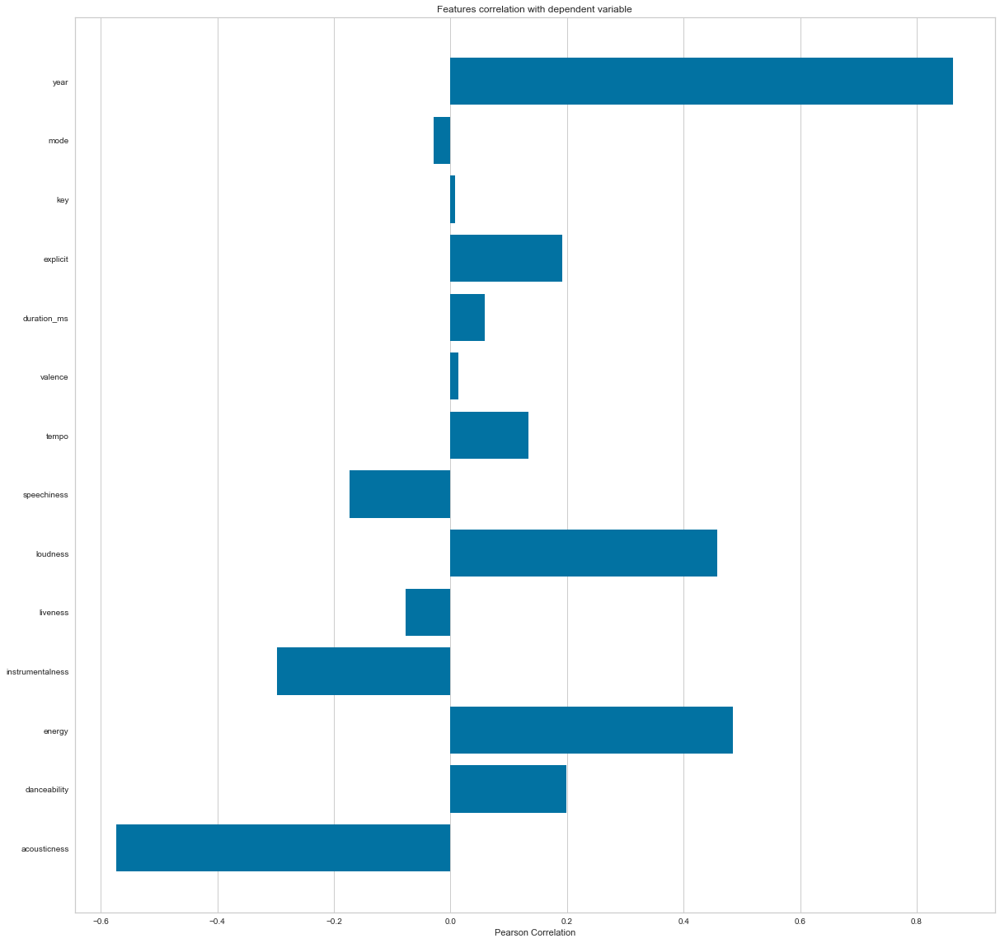

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [12]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

<AxesSubplot:>

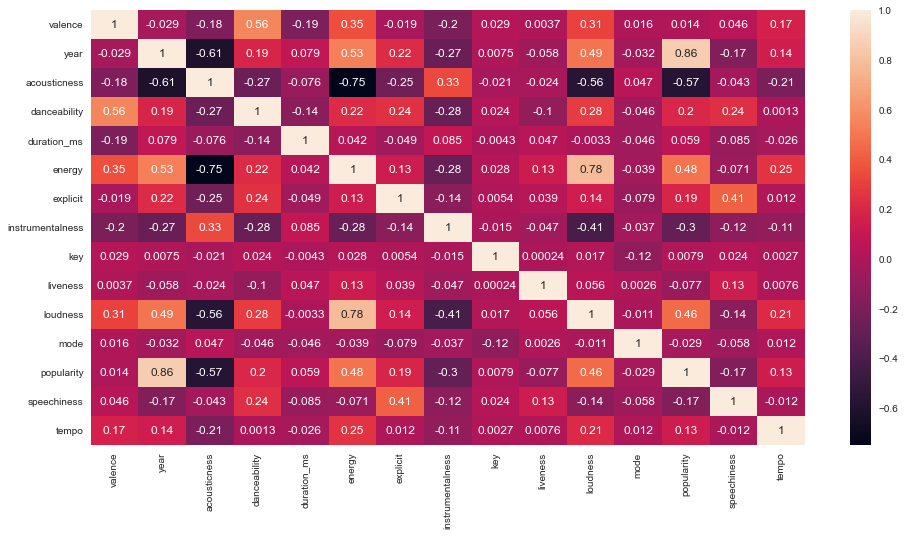

In [13]:

plt.figure(figsize=(16, 8))
sns.heatmap(data=data.corr(),annot=True)
# From this graph we can start to make connections.
# E.g, popularity and year have a strong connection. Songs that come out that year have high popularity.
# Energy and loudness have a strong connection, as we can assume that more loudness = more energy
# Danceability and valence are also fairly high, as valence is the "happy" level in music. Dancing is happy!


## Music Over Time

Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

<AxesSubplot:xlabel='decade', ylabel='count'>

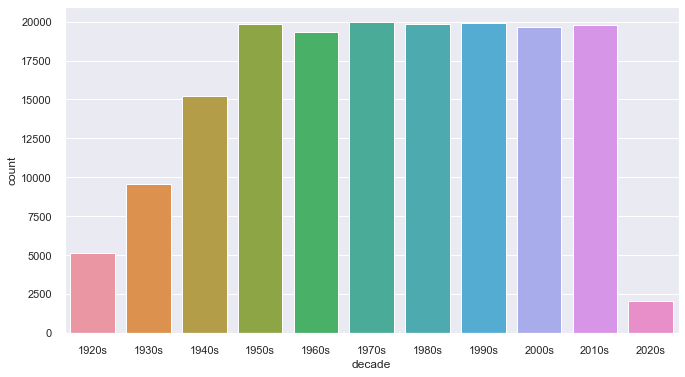

In [14]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

In [15]:

sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

<AxesSubplot:xlabel='year', ylabel='popularity'>

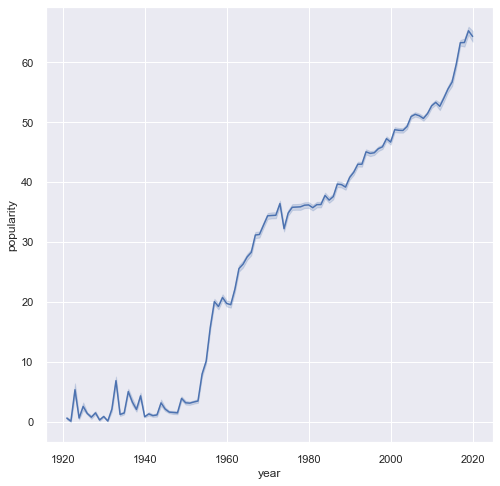

In [16]:
plt.figure(figsize=(8, 8))
sns.lineplot(x=data['year'], y=data['popularity'])
# Upwards trend in danceability from 1920 until a downward trend from approximately 1930-35...I would assume because of the war.
# This graph shows an upward trend in danceability from about 1945-1950 onwards... coinciding with the end of WWII and the onset of the 60s!

<AxesSubplot:xlabel='year', ylabel='popularity'>

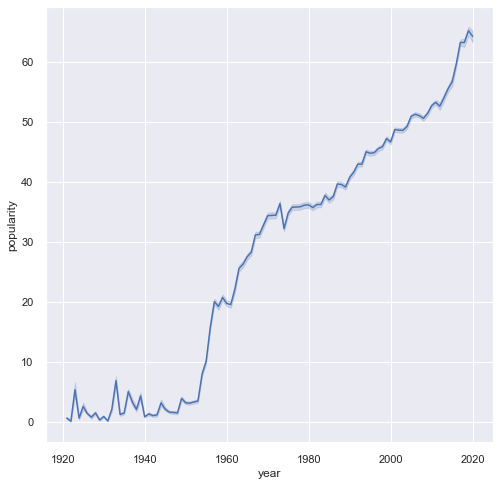

In [17]:
plt.figure(figsize=(8, 8))
sns.lineplot(x=data['year'], y=data['popularity'])
# Yep... songs released are popular in that year! Fast upward trend from the 1950s onward, probably from the end of WWII and the ability to make more
# music, as well as people being able to listen to music, AND the steep jump in the early 2000s as a result of streaming.

<AxesSubplot:xlabel='energy', ylabel='loudness'>

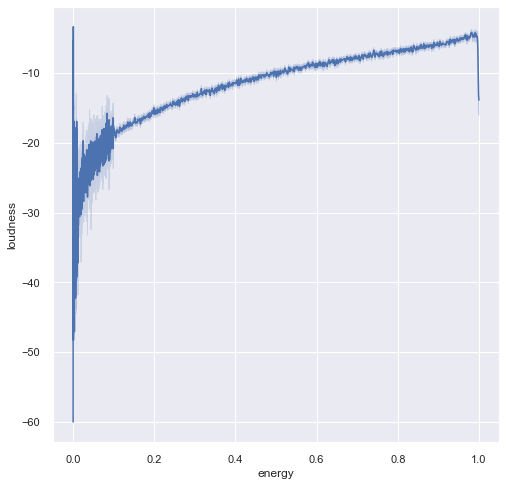

In [18]:
plt.figure(figsize=(8, 8))
sns.lineplot(x=data['energy'], y=data['loudness'])
# Interesting...some songs are loud but low energy, and fewer still that are high energy but quieter than average as seen at the top and tail ends of 
# the graph. The general consensus is that as the songs increase in loudness, the energy increases.

In [19]:
# Fixing tempo zero values. 
# Options: Drop the rows, impute the values, or leave it, I guess. 
# Dropping the rows is easy and it actually improves the accuracy since that all the values are accurate. The cons are that we 
# lose information. By imputing the values we can prevent data loss by keeping all the data.

data.loc[data.tempo==0, 'tempo'] = is_tempo

is_tempo = True
mean_tempo = data['tempo'].mean()

data['tempo']=data.tempo.mask(data.tempo == 0,mean_tempo)

print(mean_tempo)

if (data['tempo'] == 0).any():
    print("Are there zero values in tempo column? " + str(is_tempo))
else:
    is_tempo = False
    print("Are there zero values in tempo column? " + str(is_tempo))
    print("The zero tempo values were replaced with ", mean_tempo)
    
# All done! Now the zero tempo values were replaced, we can now begin our training and testing...


116.88220452729576
Are there zero values in tempo column? False
The zero tempo values were replaced with  116.88220452729576


In [20]:
# get top ten tracks (by popularity)
top_ten_tracks = data.groupby("name")['popularity'].mean().sort_values(ascending=False).head(10)
top_ten_tracks.head(10)

name
Dakiti                             100.0
Mood (feat. iann dior)              99.0
Blinding Lights                     96.0
What You Know Bout Love             96.0
WAP (feat. Megan Thee Stallion)     96.0
Lonely (with benny blanco)          95.0
you broke me first                  95.0
Holy (feat. Chance The Rapper)      95.0
Head & Heart (feat. MNEK)           94.0
Relación - Remix                    94.0
Name: popularity, dtype: float64

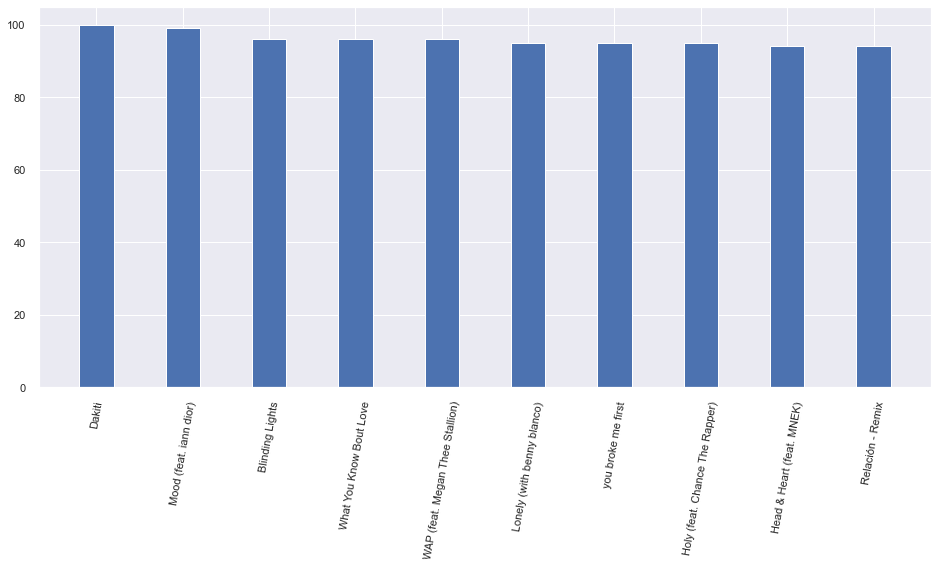

In [21]:
# closer look at the popular tracks
fig, axis = plt.subplots(figsize = (16,7))
axis = plt.bar(top_ten_tracks.index, top_ten_tracks, width=0.4)
plt.xticks(rotation = 80);

In [22]:
# Lets analyse most popular artists, The Beatles are the most popular artists
top_ten_artists = data.groupby("artists")['popularity'].sum().sort_values(ascending=False).head(10)
top_ten_artists.head(10)

artists
The Beatles           19218
Frank Sinatra         17987
Elvis Presley         17188
The Rolling Stones    16477
Fleetwood Mac         15675
Bob Dylan             14570
Led Zeppelin          13498
Queen                 13202
Johnny Cash           12802
The Beach Boys        12216
Name: popularity, dtype: int64

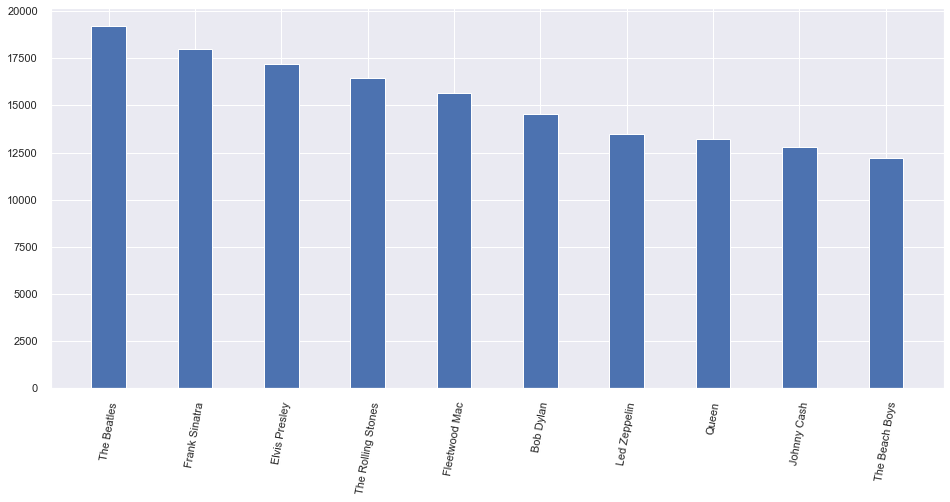

In [23]:
# closer look at popularity
fig, axis = plt.subplots(figsize = (16,7))
axis = plt.bar(top_ten_artists.index, top_ten_artists, width=0.4)
plt.xticks(rotation = 80);

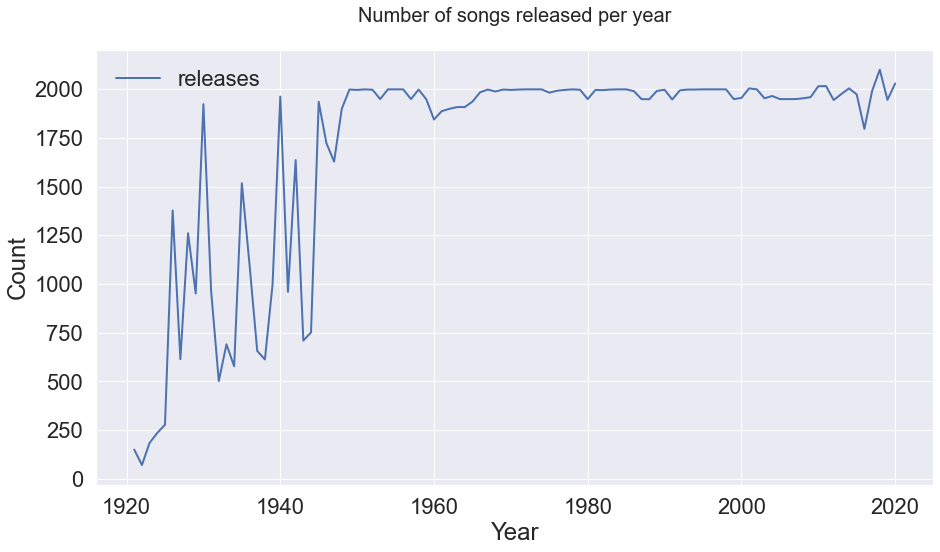

In [24]:
# numbe of song releases per year
number_of_releases = pd.DataFrame(data['year'].value_counts())
number_of_releases.rename({'year': 'releases'}, axis=1, inplace=True)
number_of_releases = number_of_releases.sort_index()
sns.set(font_scale=2) 
ax=number_of_releases.plot(kind='line',figsize=(15,8), linewidth=2)
plt.title("Number of songs released per year",y=1.05,fontsize=20)
plt.xlabel('Year')
plt.ylabel('Count')
ax.axes.get_xaxis().set_visible(True)

## Lets understand if we can build a model to predict poularity

In [25]:
from sklearn.tree import DecisionTreeRegressor

from sklearn.model_selection import train_test_split

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score,mean_absolute_error

# Our features will be all columns except for artist, id, release date (use year instead) and name. 
# Features are what our model will be based on, i.e the values provided by these columns.
feature = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness',
          'mode', 'speechiness', 'tempo']

columns = list(pd.read_csv("data/data.csv", nrows=1))
df2 = pd.read_csv('data/data.csv', usecols=[i for i in columns if i not in ['name', 'id','release_date', 'artists']])
# We aren't going to use the name, id, release date or artists column as they are not completely necessary for finding neighbours. This line of code
# is getting another copy of the dataset to remove the columns we don't need. We can exclude the columns by a small for loop in the usecols variable.
# This could be improved later by adding the artists column to the features list. This would have to include one hot encoding to deal with the categorical
# values.

X_train, X_test, y_train, y_test = train_test_split(df2.drop('popularity', axis=1), df2['popularity'], test_size = 0.2, random_state=42) 
# Just using the default, usual values for now. We use the modified dataset we just made, but drop the 'popularity' column. We then use only the 'popularity'
# column as a secondary array. Our test size tells the program how much data to use in the test split. The random_state controls the shuffling of the 
# dataset, so we don't get the same test/train split every time.

In [26]:
dtree = DecisionTreeRegressor().fit(X_train, y_train)
predict = dtree.predict(X_test)

In [27]:
print("Mean squared error is: ", format(np.power(y_test-dtree.predict(X_test),1).mean()))


Mean squared error is:  -0.4368638481146172


In [33]:
from sklearn.model_selection import GridSearchCV

# Select an algorithm
algorithm = DecisionTreeRegressor()

# Define our candidate hyperparameters
hp_candidates = {
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10]}
    
# Search for best hyperparameters
grid = GridSearchCV(estimator=algorithm, param_grid=hp_candidates)
grid.fit(X, y)

# Get the results
print(grid.best_score_)
print(grid.best_estimator_)
print(grid.best_params_)

0.7269884983531568
DecisionTreeRegressor(max_depth=7, min_samples_leaf=10)
{'max_depth': 7, 'min_samples_leaf': 10}


Mean squared error with tuned params is:  -0.0016087614388832017


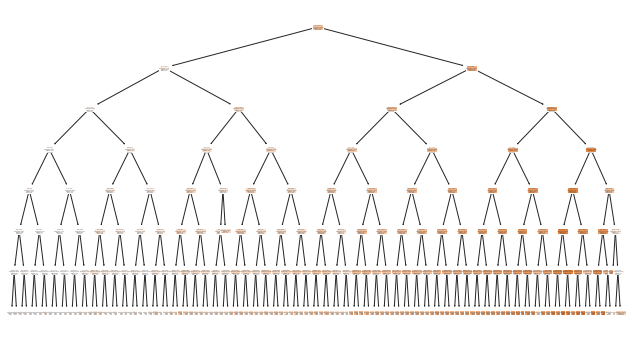

In [47]:
from sklearn import tree
import matplotlib.pyplot as plt

dtree = DecisionTreeRegressor(max_depth=7, min_samples_leaf=10).fit(X_train, y_train)
predict = dtree.predict(X_test)

print("Mean squared error with tuned params is: ", format(np.power(y_test-dtree.predict(X_test),1).mean()))


plt.figure()
tree.plot_tree(dtree,filled=True)  
plt.savefig('images/tree.eps',format='eps',bbox_inches = "tight")



In [34]:
from sklearn.neighbors import KNeighborsRegressor
# Using KNN to see what is the closest songs to each other instead of cosine similarity so i can get the proper metrics from it

In [35]:
neigh = KNeighborsRegressor(n_neighbors=20, n_jobs=2, metric='cosine')
# This will be our model. We will have 20 neighbours calculated (by default), our algorithm to search for neighbours just brute-force searches the data,
# n_jobs tells the program how many parallel jobs to run while looking for neighbours, in this case it is using all processes. metric is what we will 
# use to find the distance between neighbours. This one is cosine, so it is like looking at the vector distance between neighbours.

In [36]:
neigh.fit(X_train, y_train)
# We fit the training to the model

KNeighborsRegressor(metric='cosine', n_jobs=2, n_neighbors=20)

In [37]:
predict = neigh.predict(X_test)
# We can predict the targets for our X_test section

In [38]:
print("Mean squared error is: ", format(np.power(y_test-neigh.predict(X_test),1).mean()))
# This shows us how close the estimates are to the real values. A low value indicates a good fit for the data.

Mean squared error is:  -0.049043391638100634


In [ ]:
from sklearn.model_selection import KFold, GridSearchCV

# Select an algorithm
algorithm = KNeighborsRegressor()
# Create 3 folds
seed = 13
kfold = KFold(n_splits=3, shuffle=True, random_state=seed)
# Define our candidate hyperparameters
hp_candidates = [{'n_neighbors': [2,3,4,5,6,10,15,20,25,30], 'weights': ['uniform','distance'], 'metric' :['cosine','minkowski','euclidean','manhattan']}]

# Search for best hyperparameters
grid = GridSearchCV(estimator=algorithm, param_grid=hp_candidates, cv=kfold, scoring='r2')
grid.fit(X, y)

# Get the results
print(grid.best_score_)
print(grid.best_estimator_)
print(grid.best_params_)

## Characteristics of Different Genres

This dataset contains the audio features for different songs along with the audio features for different genres. We can use this information to compare different genres and understand their unique differences in sound.

In [40]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

## Clustering Genres with K-Means
Here, the simple K-means clustering algorithm is used to divide the genres in this dataset into ten clusters based on the numerical audio features of each genres.

In [41]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [42]:

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.002s...
[t-SNE] Computed neighbors for 2973 samples in 0.363s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.116066
[t-SNE] KL divergence after 1000 iterations: 1.390216


### Clustering Songs with K-Means


In [43]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [44]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()